In [1]:
import arrow; print(arrow.now('Europe/Vienna').format('DD.MM.YYYY - HH:mm'))

import dmyplant2
import pandas as pd
import numpy as np
from tabulate import tabulate
from pprint import pprint as pp
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)


dmyplant2.cred()
mp = dmyplant2.MyPlant(3600)

dval = dmyplant2.Validation.load_def_csv("input2.csv")
vl = dmyplant2.Validation(mp,dval, cui_log=True) 

14.04.2021 - 16:13
00 1145166 M02 POLYNT - 2 (1145166- ..
01 1175579 M05 REGENSBURG             
02 1184199 M01 ROCHE PENZBERG KWKK    
03 1198719 M02 ECOGEN ENERGY SYSTEM ..
04 1243360 M03 BMW REGENSBURG M3      
05 1243362 M02 REGENSBURG             
06 1250575 M01 ABINSK                 
07 1250578 M01 PROSPERITY WEAVING M ..
08 1310773 M01 SOTERNIX RENOVE        
09 1319133 M4 BMW MÜNCHEN            
10 1319138 M2 BMW MÜNCHEN            
11 1319151 M1 BMW MÜNCHEN            
12 1319157 M3 BMW MÜNCHEN            
13 1319997 M2 BMW MÜNCHEN            
14 1320022 M1 BMW MÜNCHEN            
15 1320030 M3 BMW MÜNCHEN            
16 1320072 M4 BMW LANDSHUT 4.10      
17 1320090 M1 BMW LANDSHUT M1        
18 1320114 M3 BMW LANDSHUT 4.10      
19 1325927 M01 LES COURONNERIES       
20 1339812 M01 DALOMA                 
21 1345851 M03 GAZ DE LACQ            
22 1352268 M6 BMW DINGOLFING 2.4     
23 1352323 M7 BMW DINGOLFING 2.4     
24 1361965 M01 FRONERI - FERENTINO    
25 1364066 M01 TOM

In [2]:
vl.dashboard;

In [3]:
dat3 = {
    102: ['Power_PowerAct', 'kW'],
    217: ['Hyd_PressCrankCase', 'mbar'],
    16546: ['Hyd_PressOilDif', 'bar'],
    161: ['Count_OpHour', 'nan'],
    69: ['Hyd_PressCoolWat', 'bar'],
}

dset3 = [
            {'col':['Power_PowerAct'], 'ylim':(0,5000), 'color':'red'},
            {'col': ['Hyd_PressCrankCase'],'ylim': [-80, 120]},
            {'col':['Hyd_PressOilDif'], 'ylim':(0,2)},
            {'col':['Hyd_PressCoolWat'],'ylim': [2, 3]},
            {'col':['Oph parts'], 'ylim':(0,10000)}
        ]

psize = (12,8)

def runplots(n0, n1, dat, plotset):
    for i, ee in enumerate(vl.engines[n0:n1]):
        lldf = ee.hist_data( 
            #ee.id, 
            itemIds= dat, 
            p_from=arrow.get(ee.val_start).to('Europe/Vienna'), 
            p_to=arrow.now('Europe/Vienna'), 
            timeCycle=600)
        lldf['Oph parts'] = lldf.Count_OpHour - ee.oph_start
        dmyplant2.dbokeh_chart(lldf, plotset, title = ee, figsize=psize)

        print(f"\nPlotting no {i+n0+1}, {ee}\n")

        if ee.get_dataItem(
            'RMD_ListBuffMAvgOilConsume_OilConsumption'):
            # Lube Oil Consuption data
            dloc = ee.Validation_period_LOC()
            dmyplant2.dbokeh_chart(dloc, [
                {'col': ['OilConsumption','LOC'],'ylim': (0,0.8)},
                {'col': ['Pow'],'ylim': (0,8000)},
            ],
            title = ee,
            figsize = psize)
        else:
            print(f"No LOC Information available on Engine {ee}\n")
        plt.show()
        

  0%|          | 0/1001 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(25435, 7), from: 12.10.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1145166_600_00.hdf
20000it [00:01, 14005.01it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1002, 7), from: 06.04.2021 - 11:20, to:   13.04.2021 - 10:15, added to ./data/1145166_600_00.hdf

Plotting no 1, 1145166 M02 POLYNT - 2 (1145166- ..

limit=3000,
start 17.01.2020 val start 12.10.2020


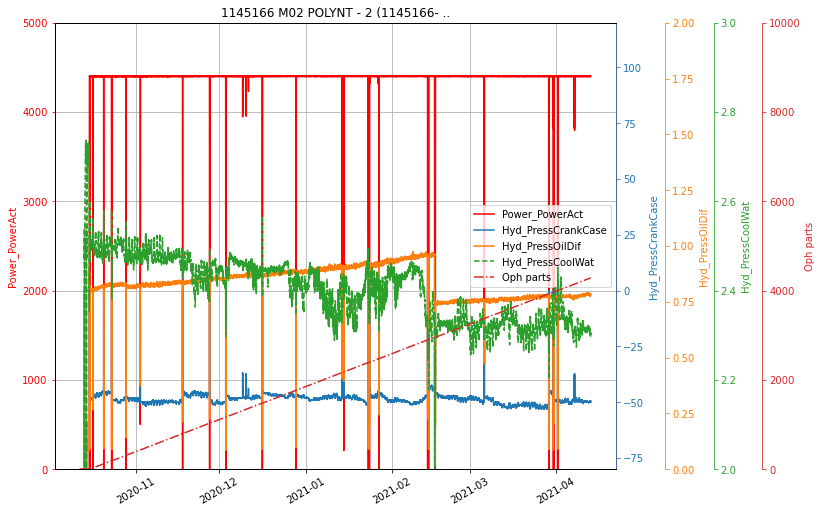

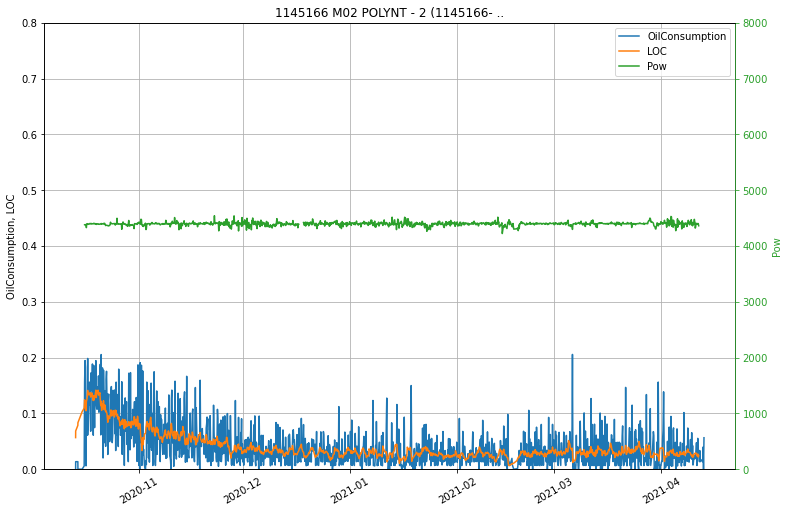

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(29470, 7), from: 14.09.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1175579_600_00.hdf
20000it [00:01, 15678.63it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1175579_600_00.hdf

Plotting no 2, 1175579 M05 REGENSBURG             

No LOC Information available on Engine 1175579 M05 REGENSBURG             



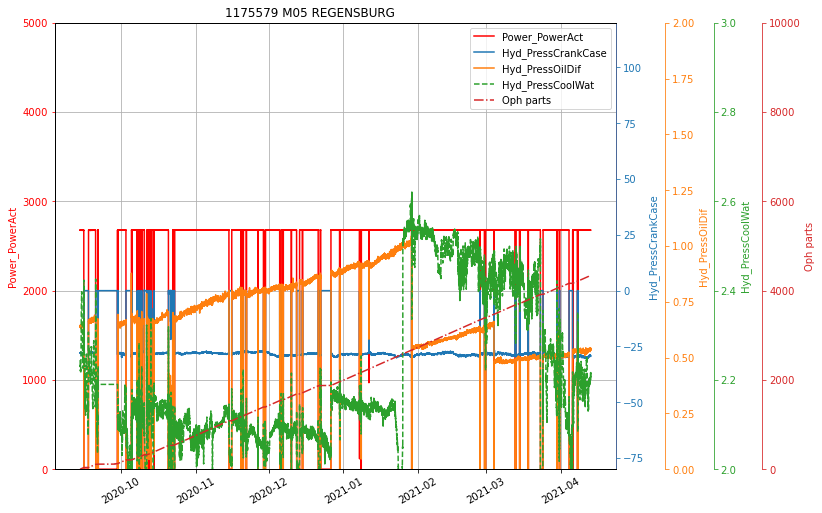

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(49603, 7), from: 27.04.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1184199_600_00.hdf
20000it [00:01, 14500.59it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1184199_600_00.hdf

Plotting no 3, 1184199 M01 ROCHE PENZBERG KWKK    

LOC, all available data received,
start 27.06.2016 val start 27.04.2020


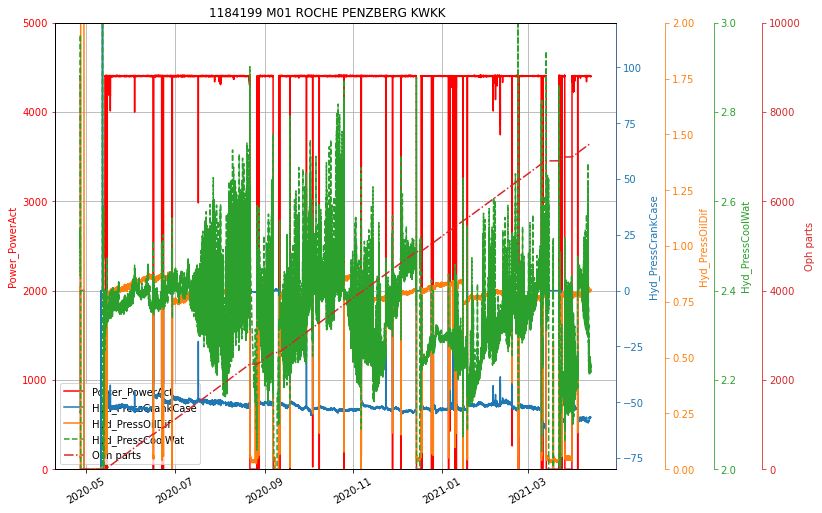

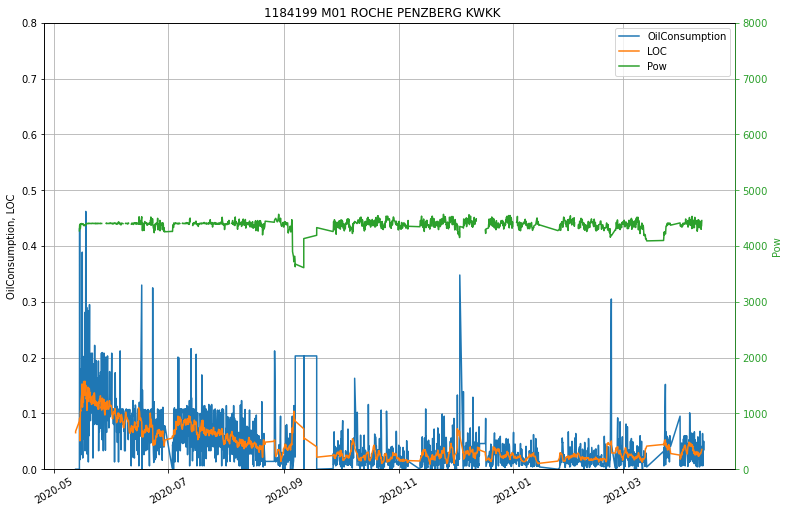

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(24978, 7), from: 15.10.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1198719_600_00.hdf
20000it [00:01, 12812.04it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1198719_600_00.hdf

Plotting no 4, 1198719 M02 ECOGEN ENERGY SYSTEM ..

limit=3000,
start 30.09.2019 val start 15.10.2020


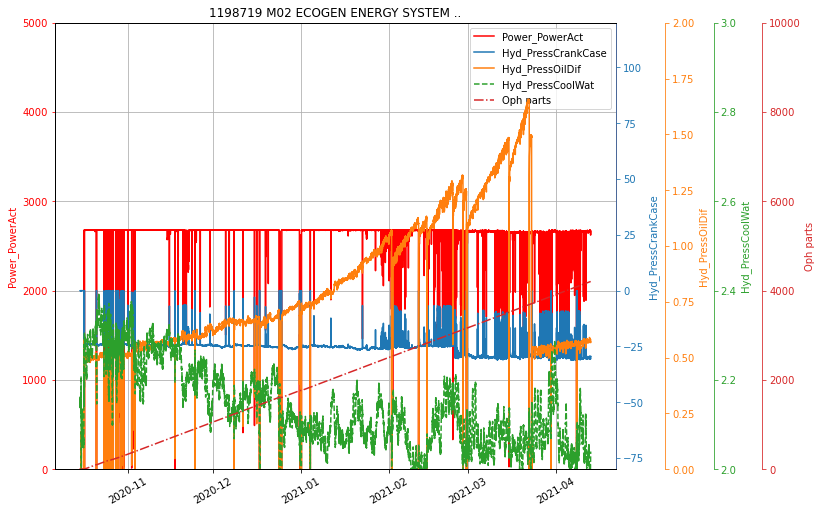

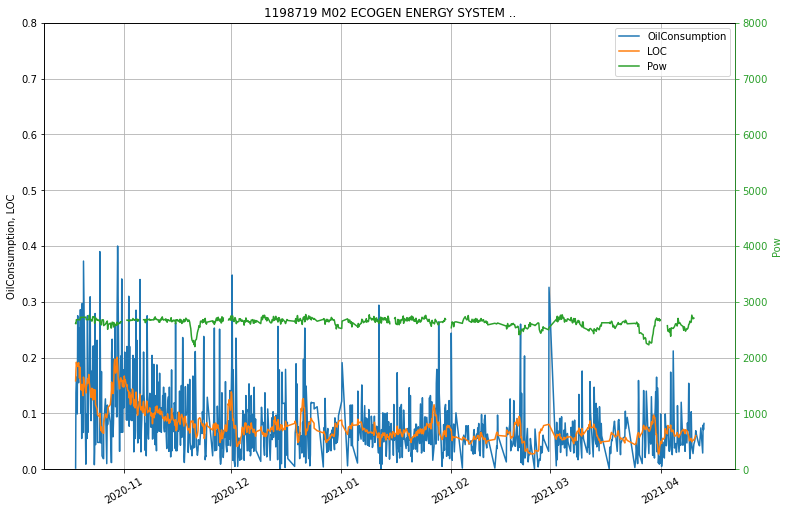

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(33474, 7), from: 17.08.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1243360_600_00.hdf
20000it [00:01, 16786.00it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1243360_600_00.hdf

Plotting no 5, 1243360 M03 BMW REGENSBURG M3      

No LOC Information available on Engine 1243360 M03 BMW REGENSBURG M3      



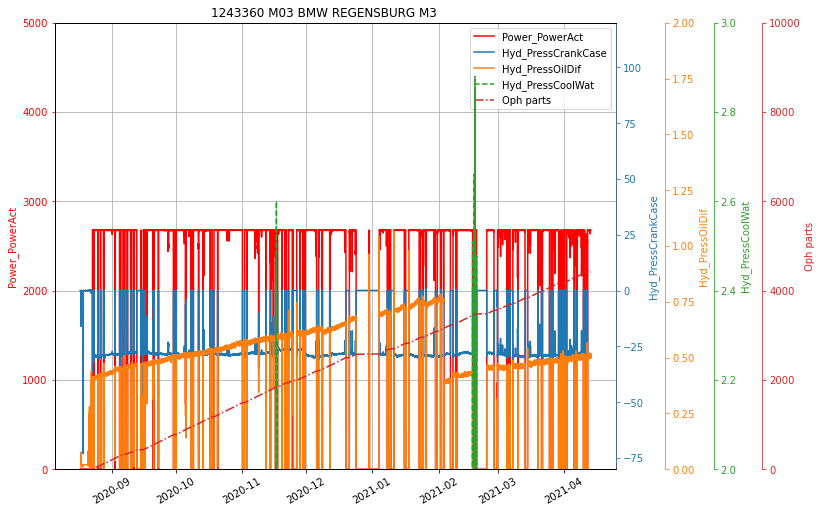

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(29944, 7), from: 07.09.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1243362_600_00.hdf
20000it [00:01, 14094.90it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1243362_600_00.hdf

Plotting no 6, 1243362 M02 REGENSBURG             

No LOC Information available on Engine 1243362 M02 REGENSBURG             



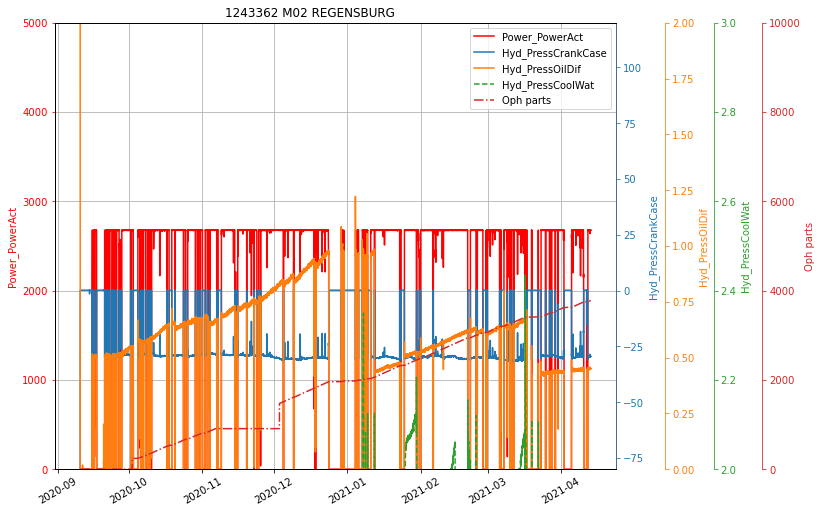

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(34984, 7), from: 15.06.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1250575_600_00.hdf
20000it [00:00, 26736.98it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1250575_600_00.hdf

Plotting no 7, 1250575 M01 ABINSK                 

No LOC Information available on Engine 1250575 M01 ABINSK                 



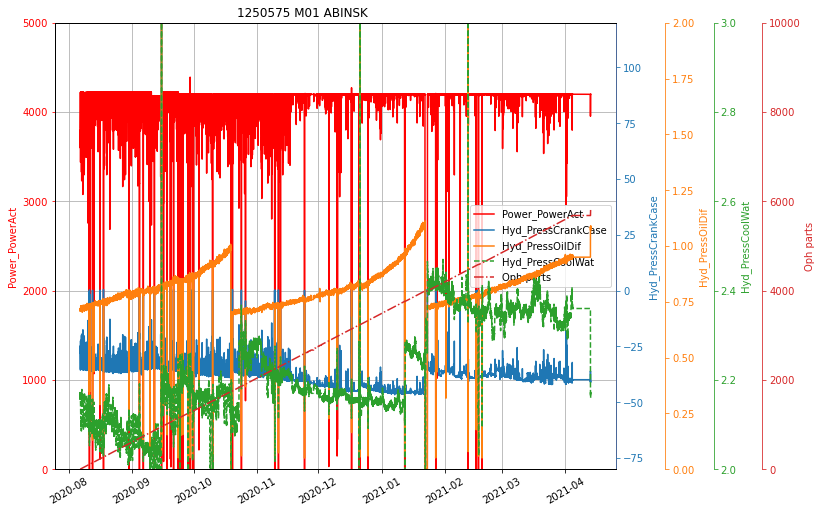

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(25365, 7), from: 12.10.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1250578_600_00.hdf
20000it [00:01, 13181.37it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1250578_600_00.hdf

Plotting no 8, 1250578 M01 PROSPERITY WEAVING M ..

No LOC Information available on Engine 1250578 M01 PROSPERITY WEAVING M ..



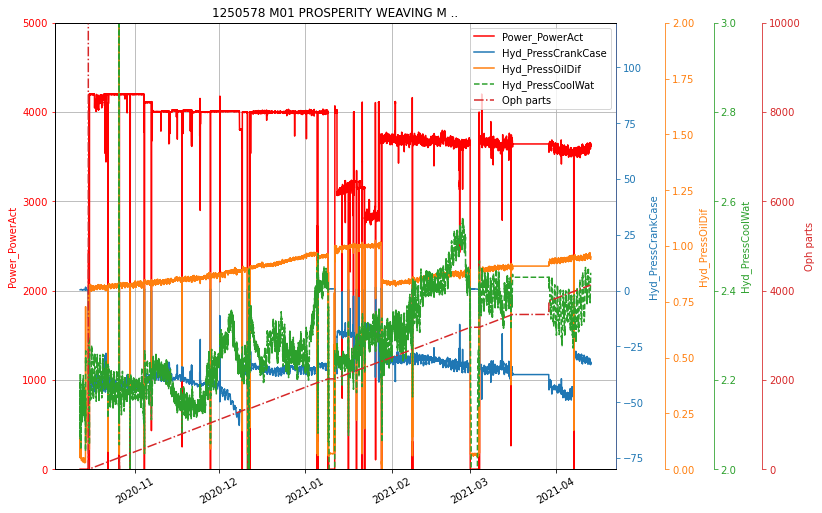

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(27858, 7), from: 25.09.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1310773_600_00.hdf
20000it [00:01, 16265.79it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:15, added to ./data/1310773_600_00.hdf

Plotting no 9, 1310773 M01 SOTERNIX RENOVE        

No LOC Information available on Engine 1310773 M01 SOTERNIX RENOVE        



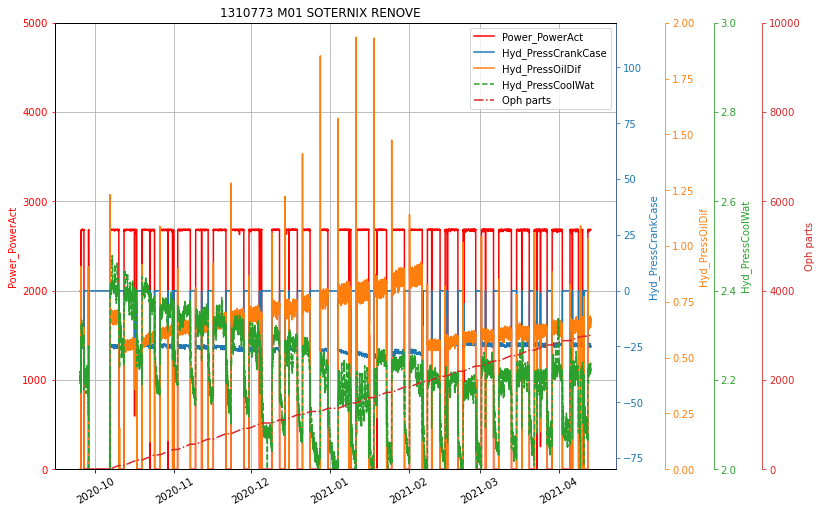

40000it [00:14, 2786.97it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(32449, 7), from: 31.08.2020 - 02:00, to:   13.04.2021 - 10:15, added to ./data/1319133_600_00.hdf

Plotting no 10, 1319133 M4 BMW MÜNCHEN            

LOC, all available data received,
start 28.04.2018 val start 31.08.2020


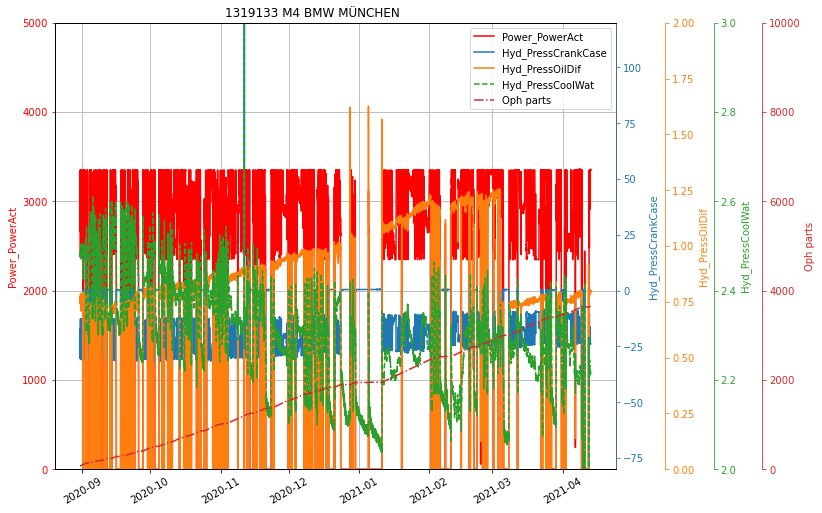

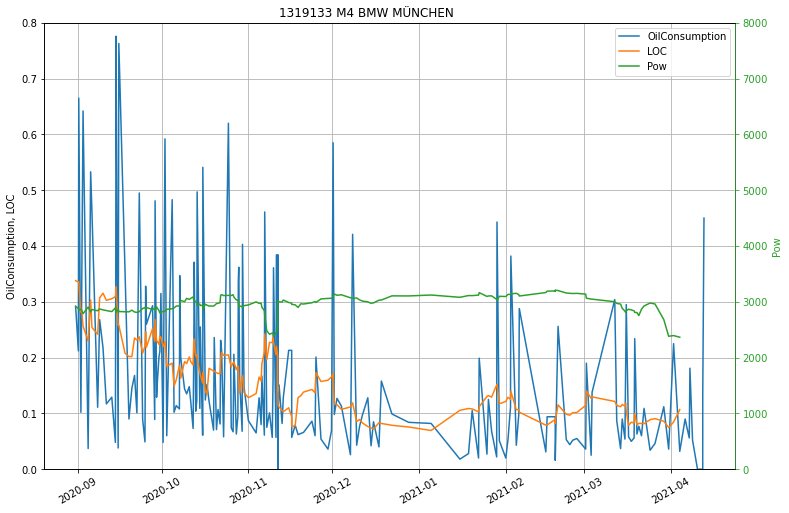

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(37506, 7), from: 20.07.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1319138_600_00.hdf
20000it [00:01, 16646.65it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1319138_600_00.hdf

Plotting no 11, 1319138 M2 BMW MÜNCHEN            

LOC, all available data received,
start 26.04.2018 val start 20.07.2020


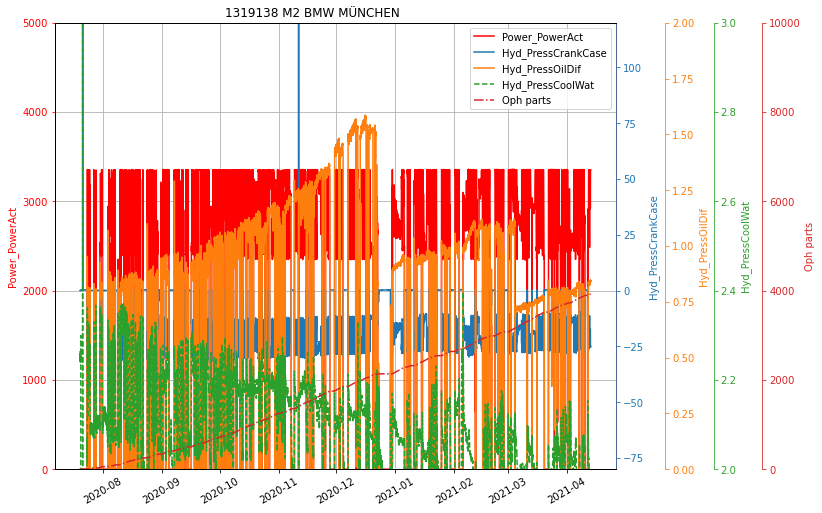

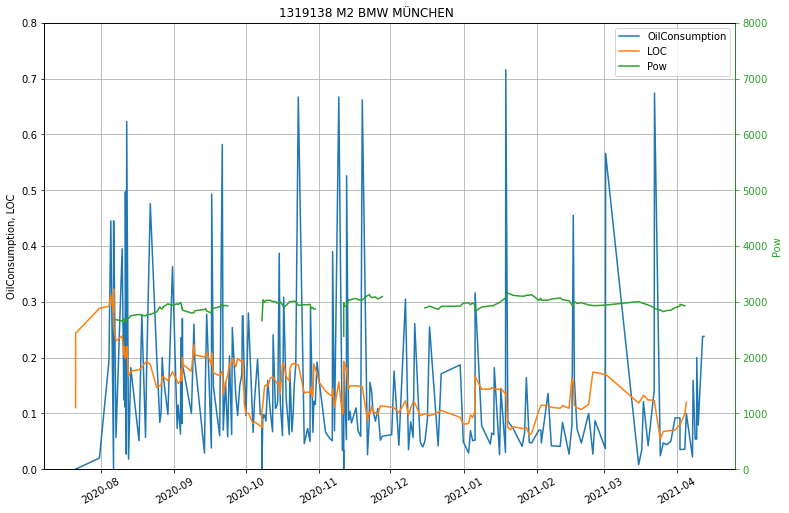

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(39522, 7), from: 06.07.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1319151_600_00.hdf
20000it [00:01, 15055.76it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1319151_600_00.hdf

Plotting no 12, 1319151 M1 BMW MÜNCHEN            

LOC, all available data received,
start 27.04.2018 val start 06.07.2020


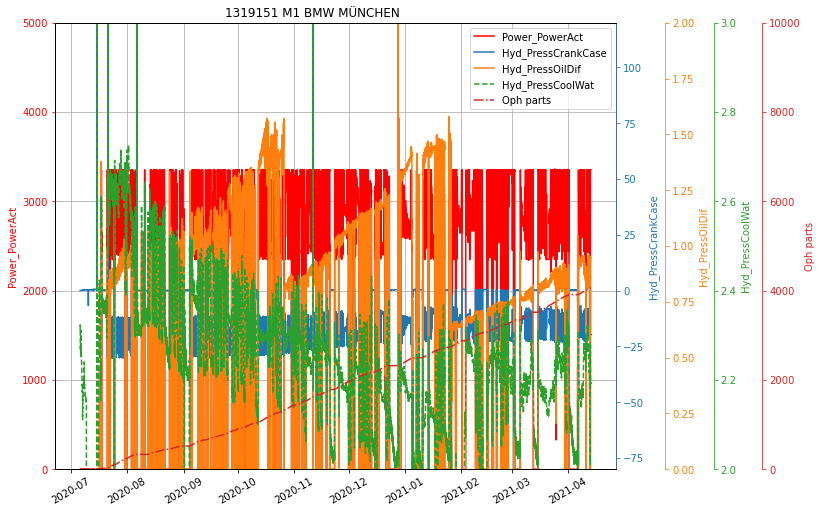

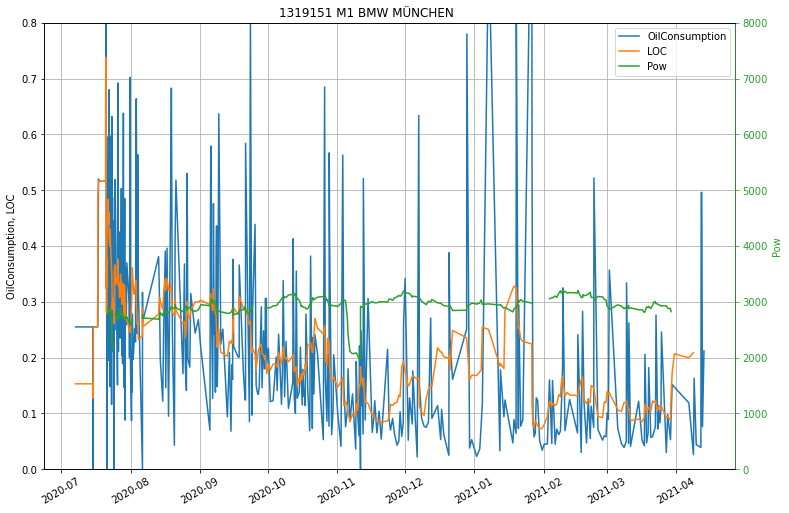

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(33474, 7), from: 17.08.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1319157_600_00.hdf
20000it [00:01, 15112.41it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1319157_600_00.hdf

Plotting no 13, 1319157 M3 BMW MÜNCHEN            

LOC, all available data received,
start 26.04.2018 val start 17.08.2020


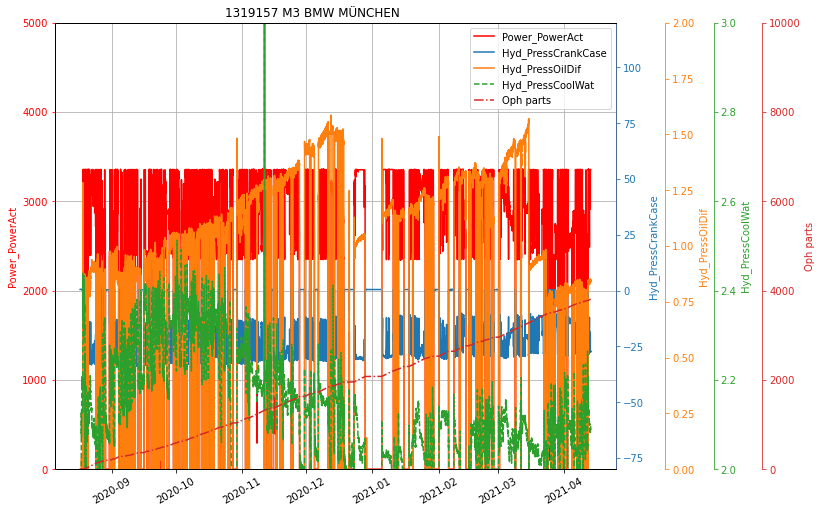

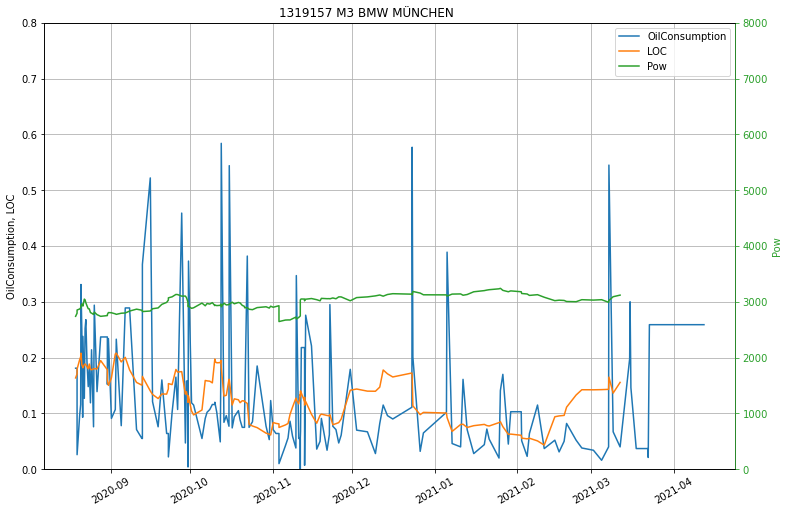

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(32466, 7), from: 24.08.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1319997_600_00.hdf
20000it [00:01, 16023.34it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1319997_600_00.hdf

Plotting no 14, 1319997 M2 BMW MÜNCHEN            

LOC, all available data received,
start 10.03.2018 val start 24.08.2020


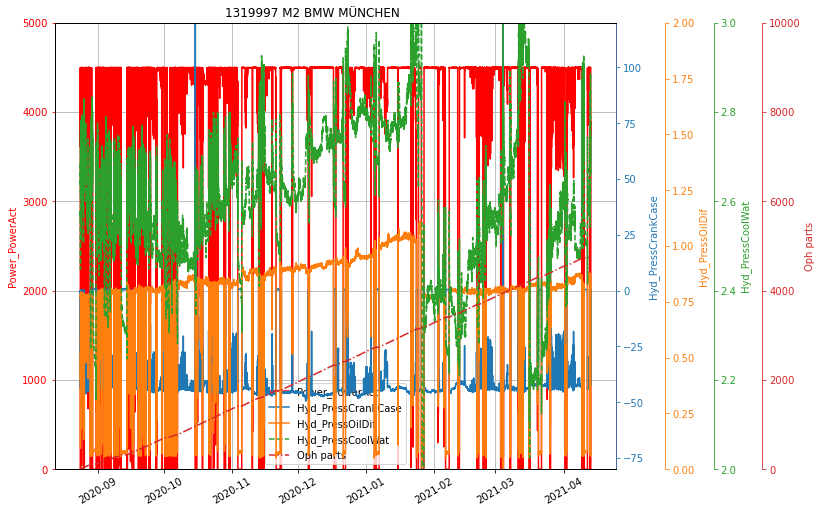

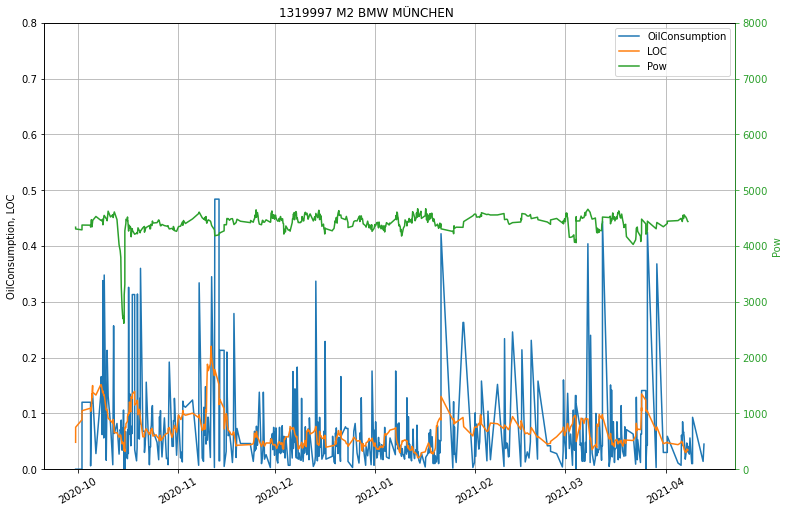

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(43553, 7), from: 08.06.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1320022_600_00.hdf
20000it [00:01, 15452.16it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1320022_600_00.hdf

Plotting no 15, 1320022 M1 BMW MÜNCHEN            

LOC, all available data received,
start 07.03.2018 val start 08.06.2020


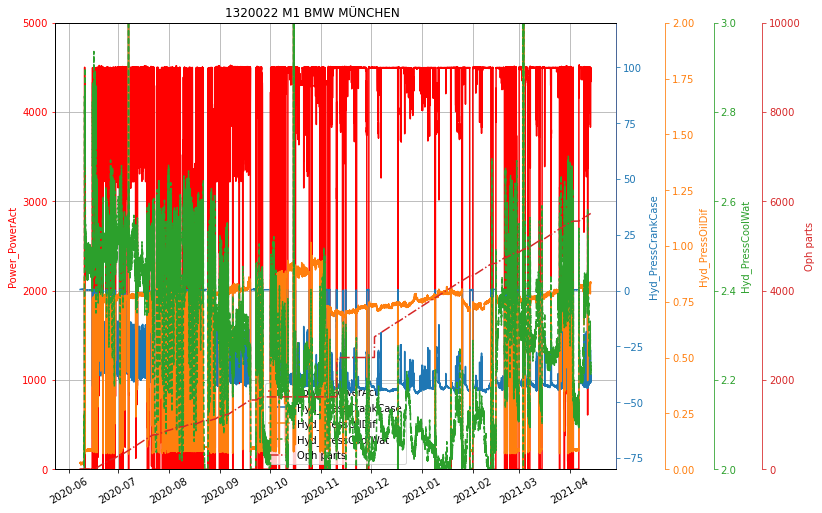

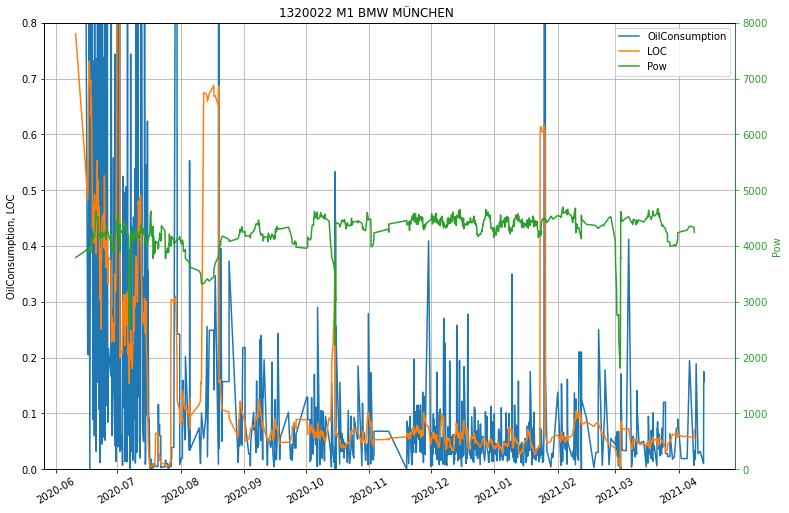

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(35490, 7), from: 03.08.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1320030_600_00.hdf
20000it [00:01, 13212.58it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1320030_600_00.hdf

Plotting no 16, 1320030 M3 BMW MÜNCHEN            

LOC, all available data received,
start 13.03.2018 val start 03.08.2020


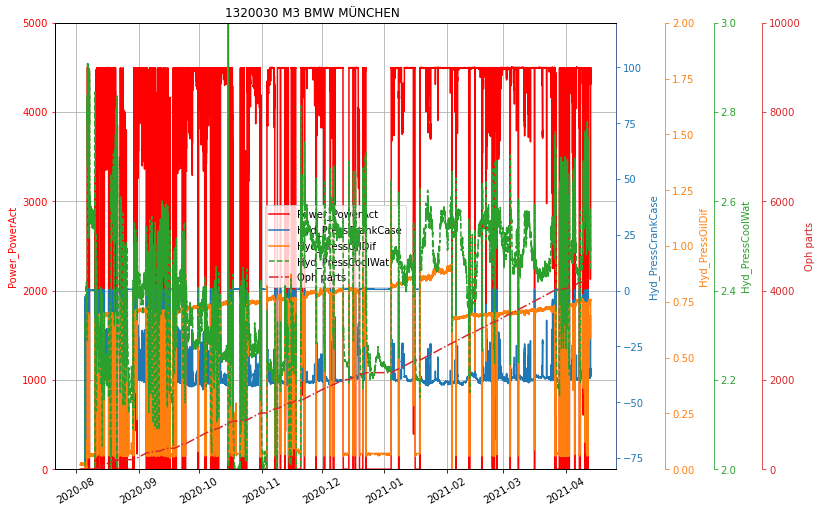

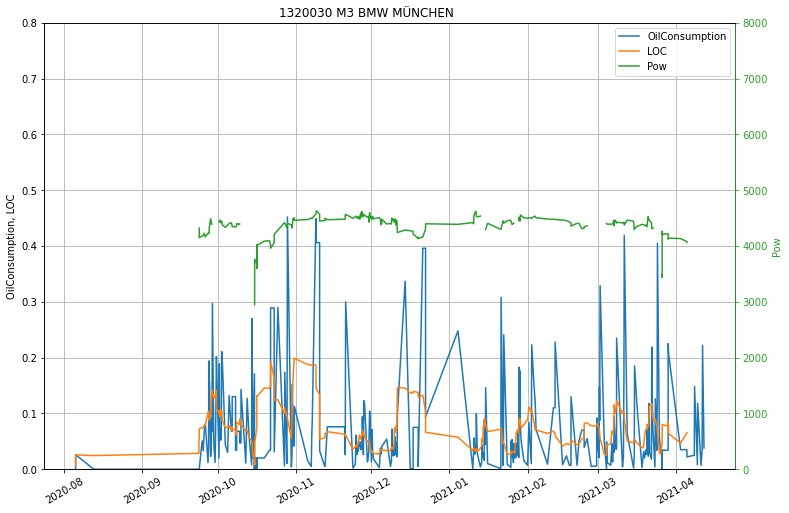

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(61120, 7), from: 07.02.2020 - 01:00, to:   06.04.2021 - 11:30, loaded from ./data/1320072_600_00.hdf
20000it [00:01, 15835.59it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:16, added to ./data/1320072_600_00.hdf

Plotting no 17, 1320072 M4 BMW LANDSHUT 4.10      

LOC, all available data received,
start 21.06.2018 val start 07.02.2020


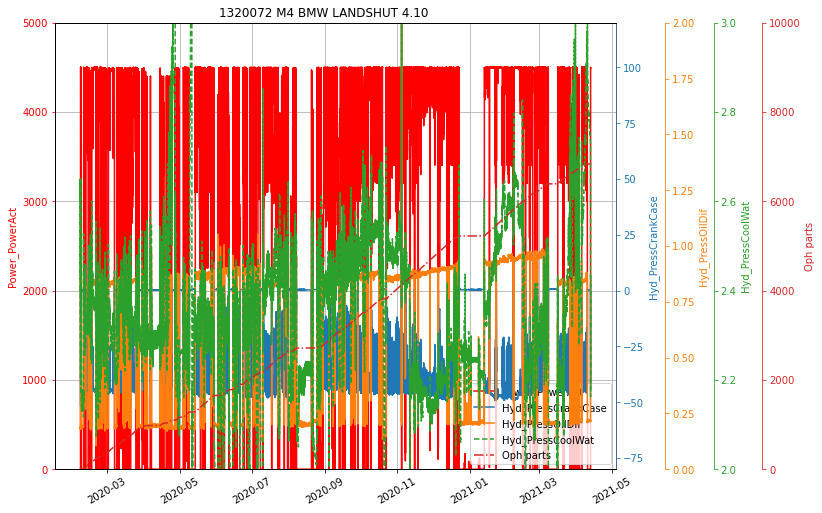

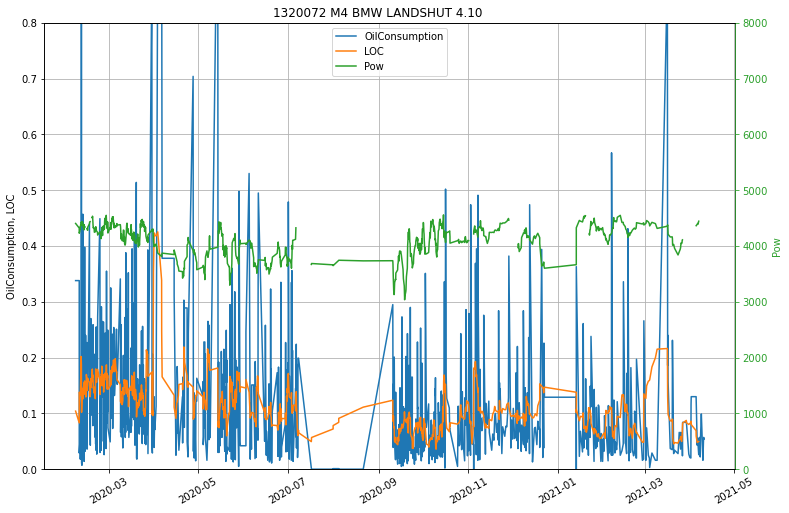

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(25408, 7), from: 12.10.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1320090_600_00.hdf
20000it [00:01, 15049.53it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:17, added to ./data/1320090_600_00.hdf

Plotting no 18, 1320090 M1 BMW LANDSHUT M1        

LOC, all available data received,
start 16.12.2017 val start 12.10.2020


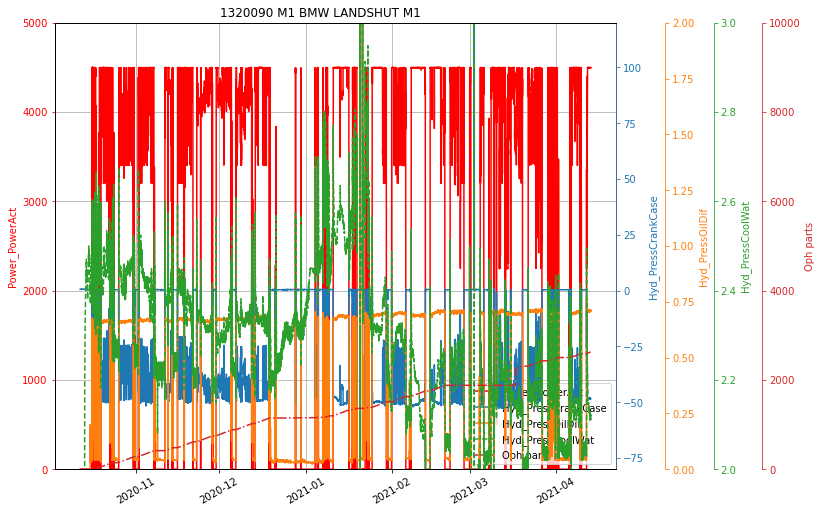

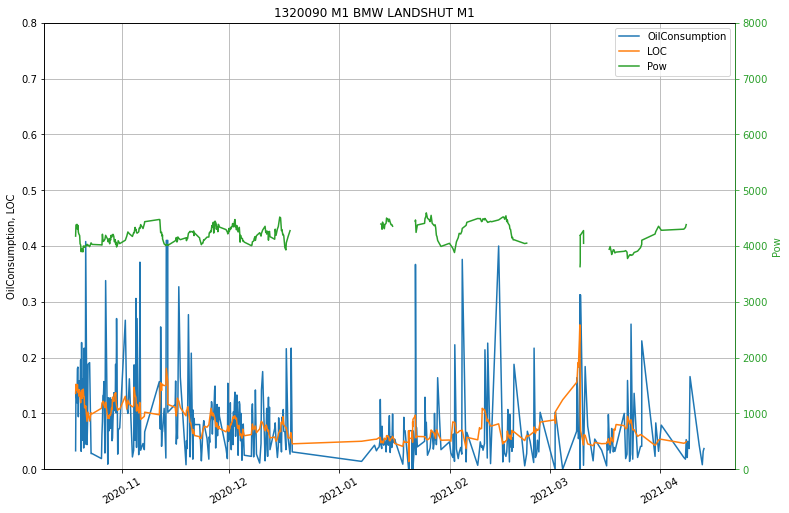

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(58671, 7), from: 24.02.2020 - 01:00, to:   06.04.2021 - 11:30, loaded from ./data/1320114_600_00.hdf
20000it [00:01, 14882.51it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:17, added to ./data/1320114_600_00.hdf

Plotting no 19, 1320114 M3 BMW LANDSHUT 4.10      

LOC, all available data received,
start 03.07.2018 val start 24.02.2020


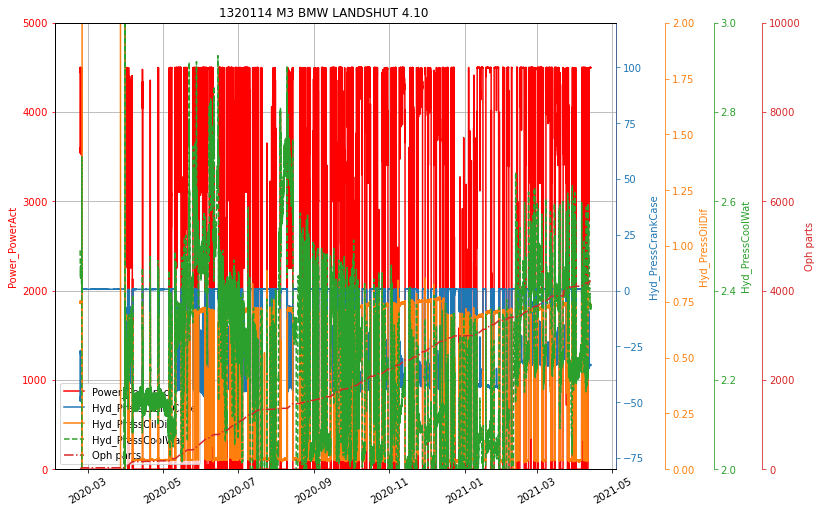

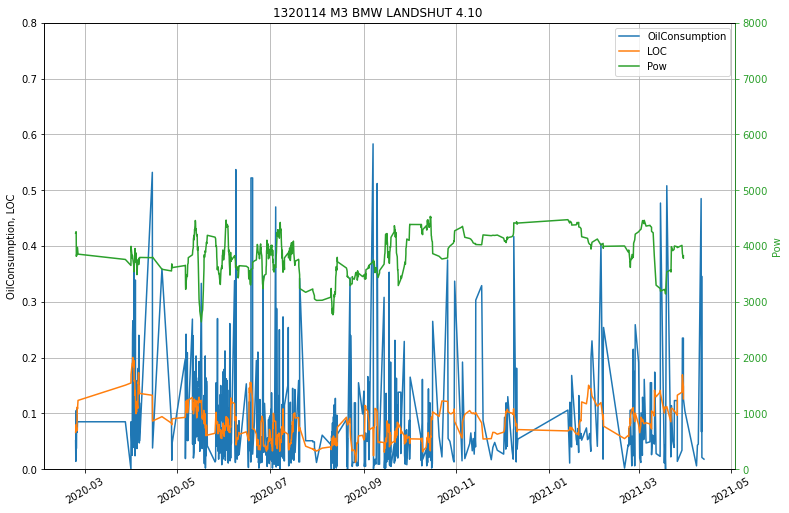

  0%|          | 0/1000 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(30160, 7), from: 09.09.2020 - 02:00, to:   06.04.2021 - 11:30, loaded from ./data/1325927_600_00.hdf
20000it [00:00, 21628.21it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(1001, 7), from: 06.04.2021 - 11:30, to:   13.04.2021 - 10:17, added to ./data/1325927_600_00.hdf

Plotting no 20, 1325927 M01 LES COURONNERIES       

LOC, all available data received,
start 12.01.2018 val start 09.09.2020


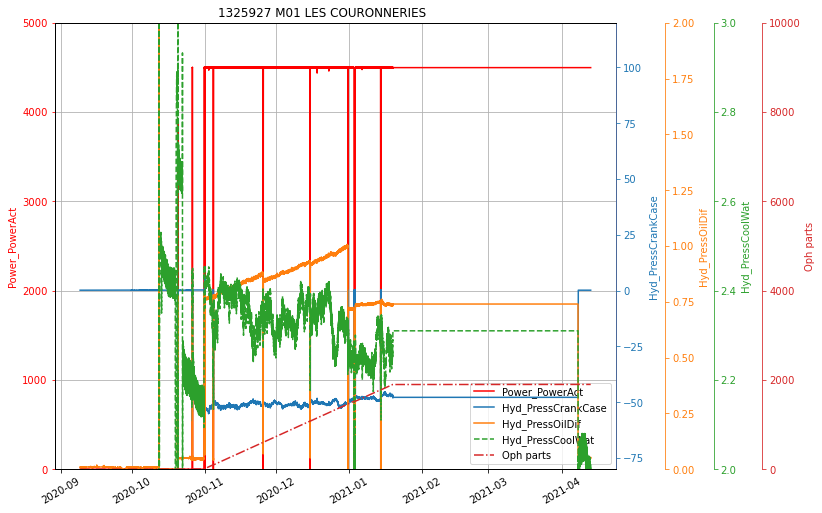

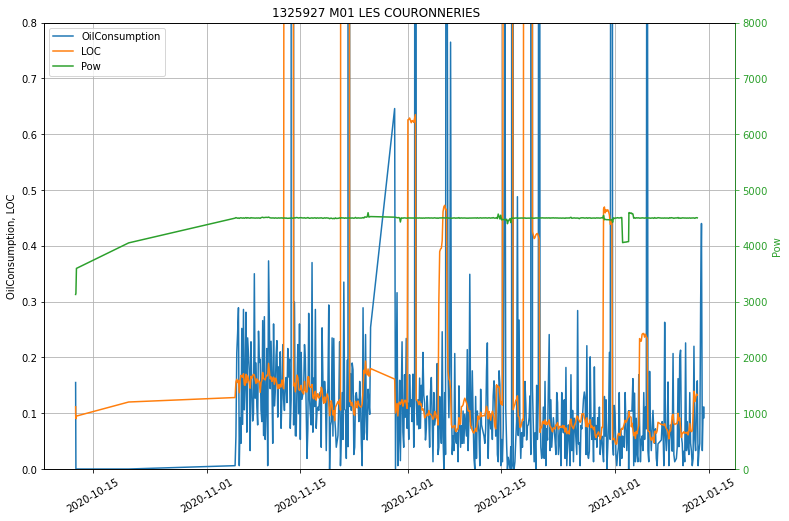

Wall time: 2min 27s


In [4]:
%%time
#runplots(0,2, dat3, dset3)
runplots(0,20, dat3, dset3)

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(22379, 7), from: 02.11.2020 - 01:00, to:   06.04.2021 - 11:20, loaded from ./data/1339812_600_00.hdf
20000it [00:00, 30903.79it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:46, added to ./data/1339812_600_00.hdf

Plotting no 21, 1339812 M01 DALOMA                 

No LOC Information available on Engine 1339812 M01 DALOMA                 



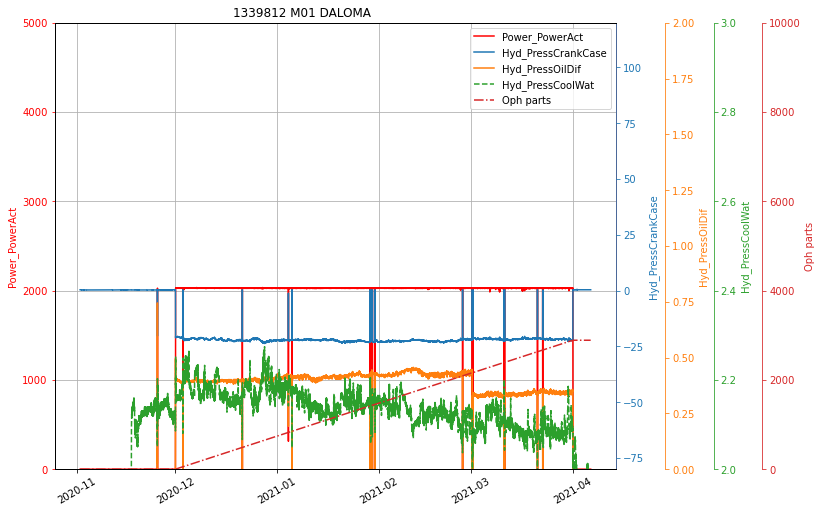

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(23963, 7), from: 22.10.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1345851_600_00.hdf
20000it [00:00, 25060.43it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:46, added to ./data/1345851_600_00.hdf

Plotting no 22, 1345851 M03 GAZ DE LACQ            

No LOC Information available on Engine 1345851 M03 GAZ DE LACQ            



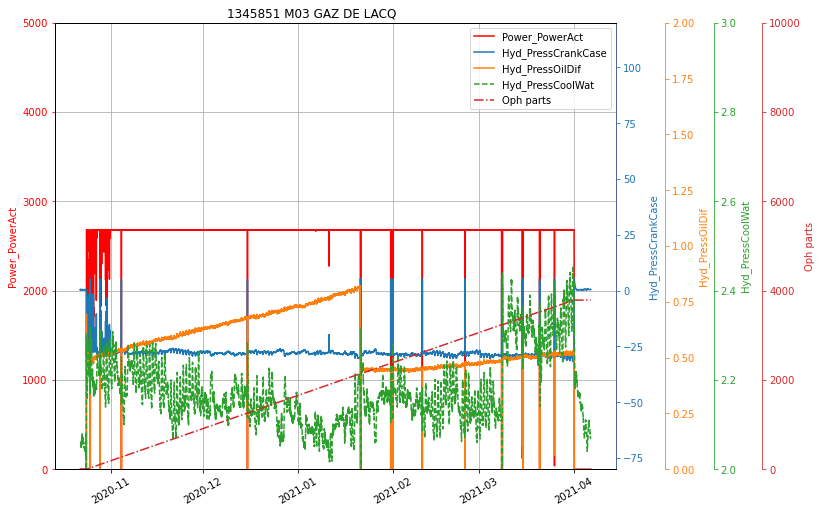

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(48586, 7), from: 04.05.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1352268_600_00.hdf
20000it [00:10, 1882.90it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:46, added to ./data/1352268_600_00.hdf

Plotting no 23, 1352268 M6 BMW DINGOLFING 2.4     

LOC, all available data received,
start 07.08.2018 val start 04.05.2020


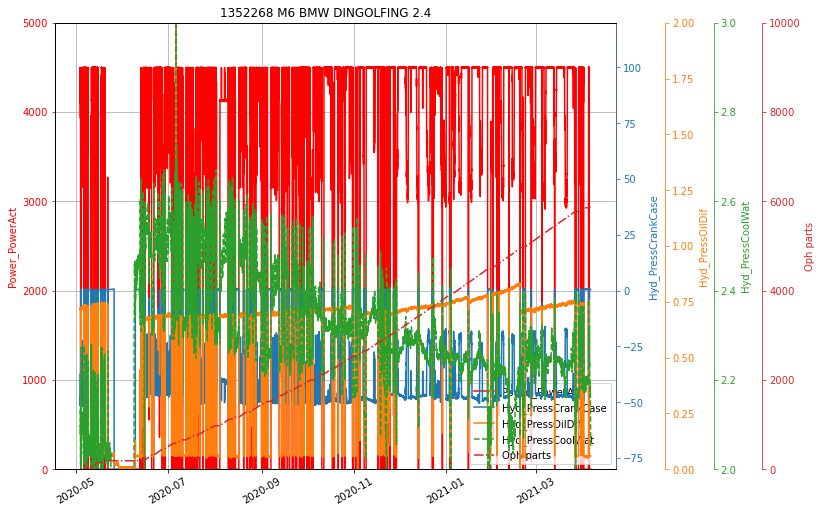

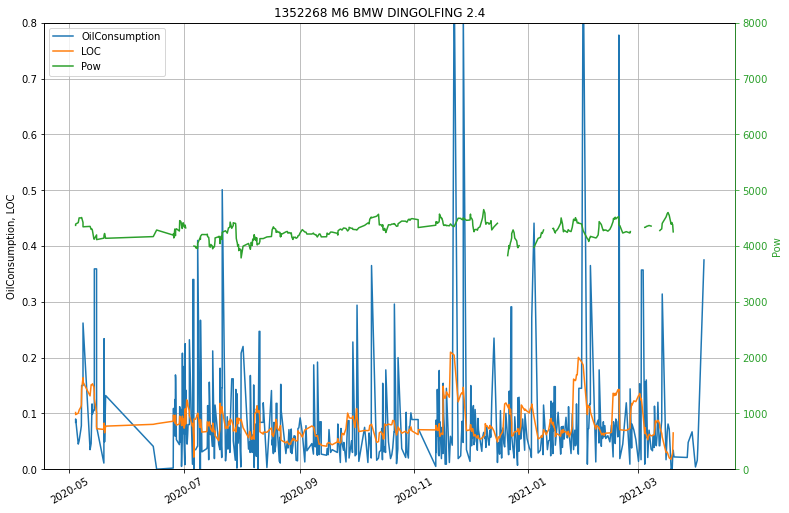

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(41530, 7), from: 22.06.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1352323_600_00.hdf
20000it [00:01, 12694.52it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:46, added to ./data/1352323_600_00.hdf

Plotting no 24, 1352323 M7 BMW DINGOLFING 2.4     

limit=3000,
start 01.07.2019 val start 22.06.2020


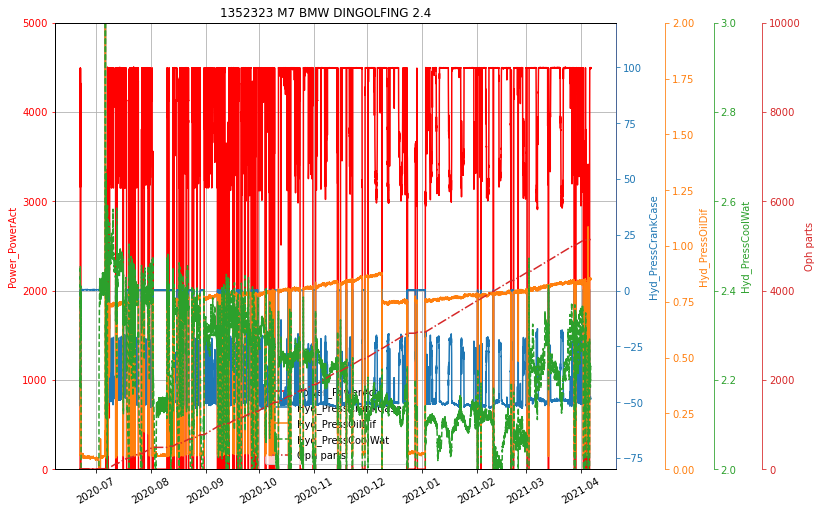

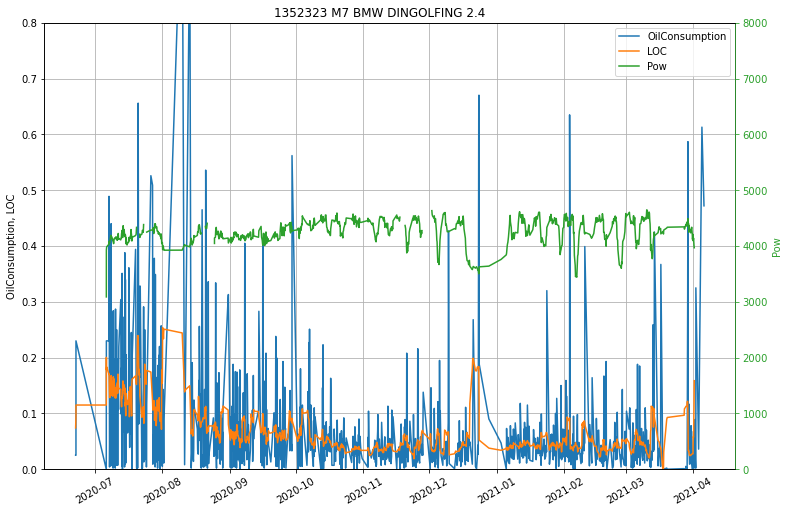

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(20075, 7), from: 18.11.2020 - 01:00, to:   06.04.2021 - 11:20, loaded from ./data/1361965_600_00.hdf
20000it [00:00, 30824.87it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:47, added to ./data/1361965_600_00.hdf

Plotting no 25, 1361965 M01 FRONERI - FERENTINO    

LOC, all available data received,
start 23.05.2018 val start 18.11.2020


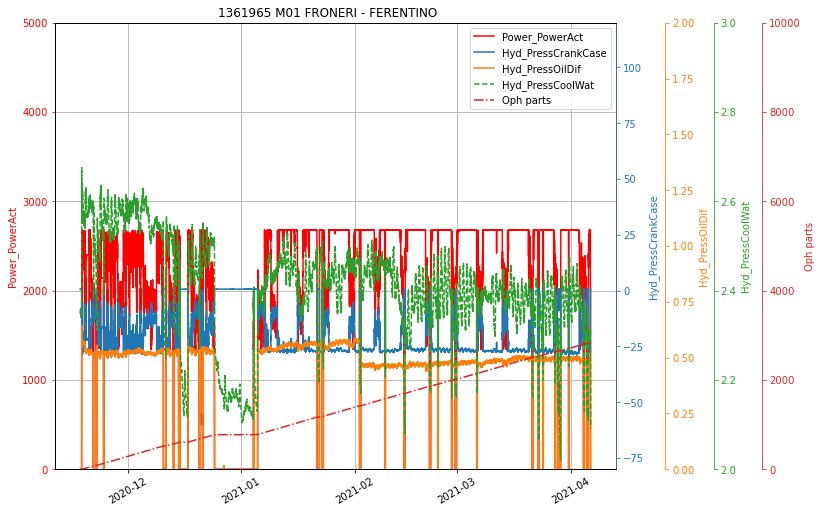

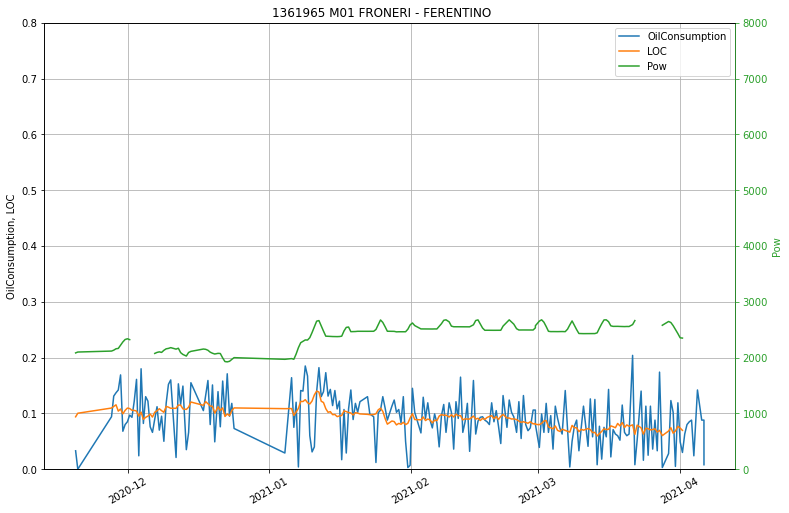

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(27851, 7), from: 25.09.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1364066_600_00.hdf
20000it [00:00, 28279.79it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:47, added to ./data/1364066_600_00.hdf

Plotting no 26, 1364066 M01 TOM VILLE              

No LOC Information available on Engine 1364066 M01 TOM VILLE              



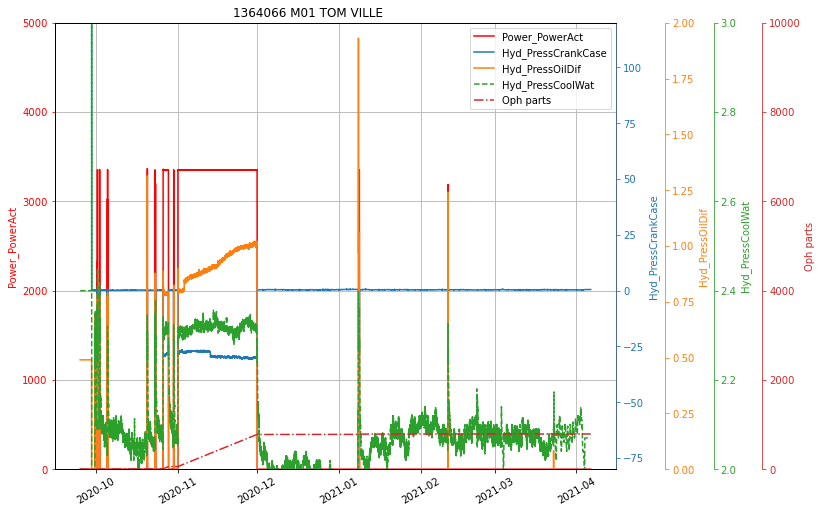

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(16764, 7), from: 11.12.2020 - 01:00, to:   06.04.2021 - 11:20, loaded from ./data/1386147_600_00.hdf
20000it [00:00, 32234.43it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:47, added to ./data/1386147_600_00.hdf

Plotting no 27, 1386147 M06 ABINSK                 

LOC, all available data received,
start 28.11.2018 val start 11.12.2020


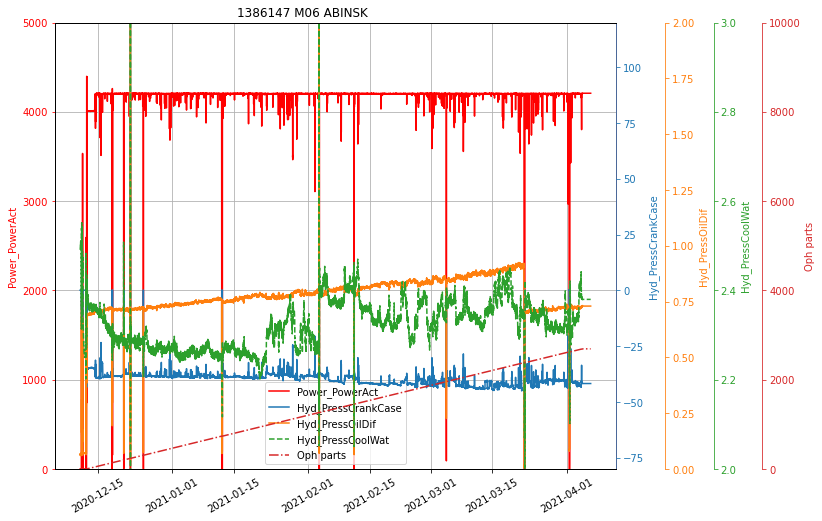

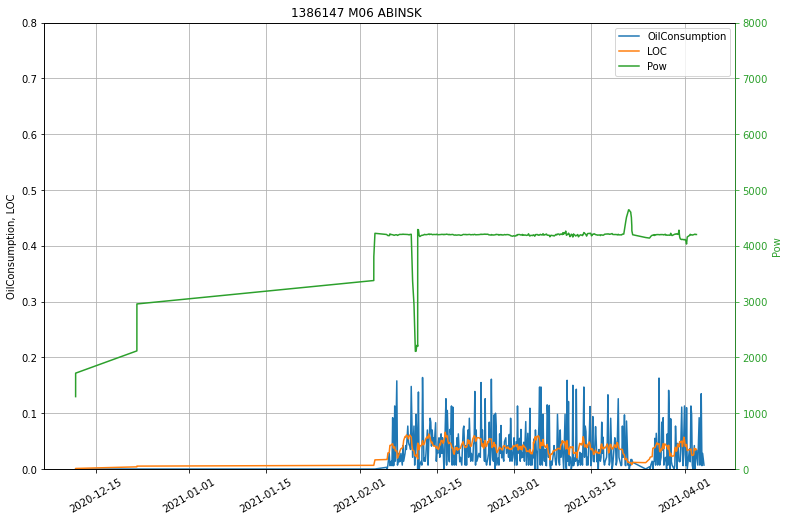

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(57658, 7), from: 02.03.2020 - 01:00, to:   06.04.2021 - 11:20, loaded from ./data/1386177_600_00.hdf
20000it [00:00, 28133.26it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:47, added to ./data/1386177_600_00.hdf

Plotting no 28, 1386177 M09 ABINSK                 

No LOC Information available on Engine 1386177 M09 ABINSK                 



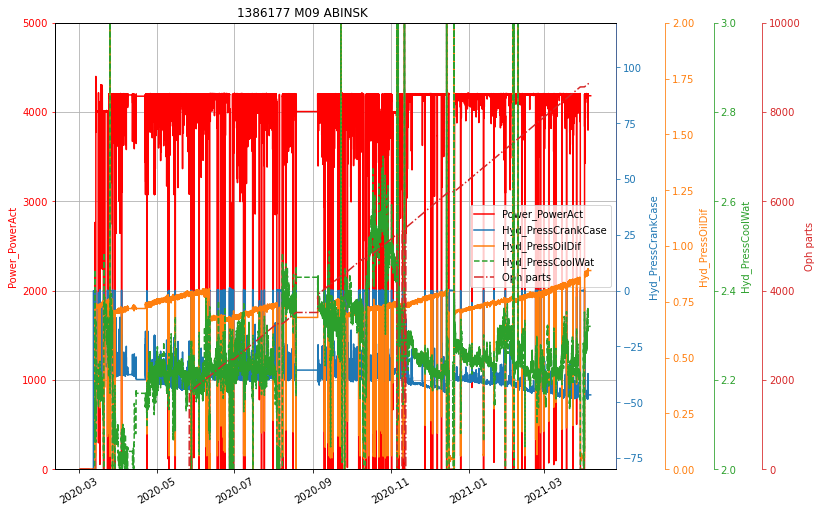

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(38507, 7), from: 13.07.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1386260_600_00.hdf
20000it [00:00, 25468.40it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:47, added to ./data/1386260_600_00.hdf

Plotting no 29, 1386260 M10 ABINSK                 

No LOC Information available on Engine 1386260 M10 ABINSK                 



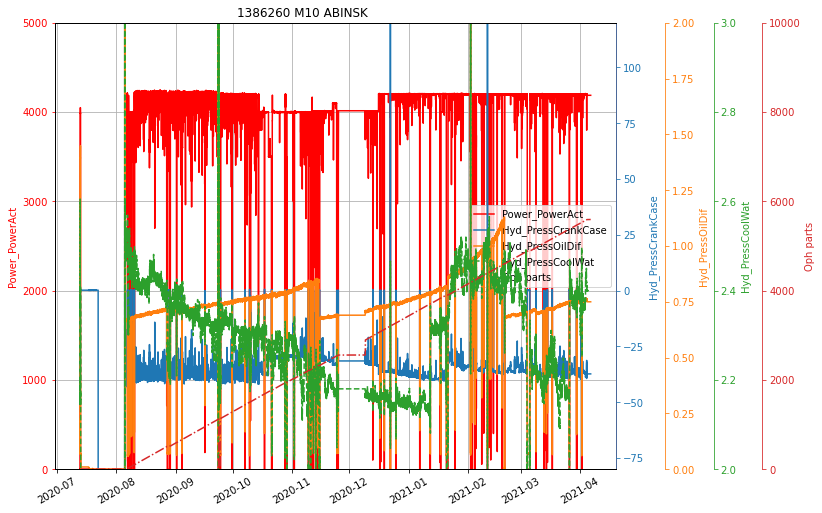

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(54634, 7), from: 23.03.2020 - 01:00, to:   06.04.2021 - 11:20, loaded from ./data/1393153_600_00.hdf
20000it [00:00, 27886.87it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:48, added to ./data/1393153_600_00.hdf

Plotting no 30, 1393153 M01 BLESSED TEXTILE        

LOC, all available data received,
start 14.02.2020 val start 23.03.2020


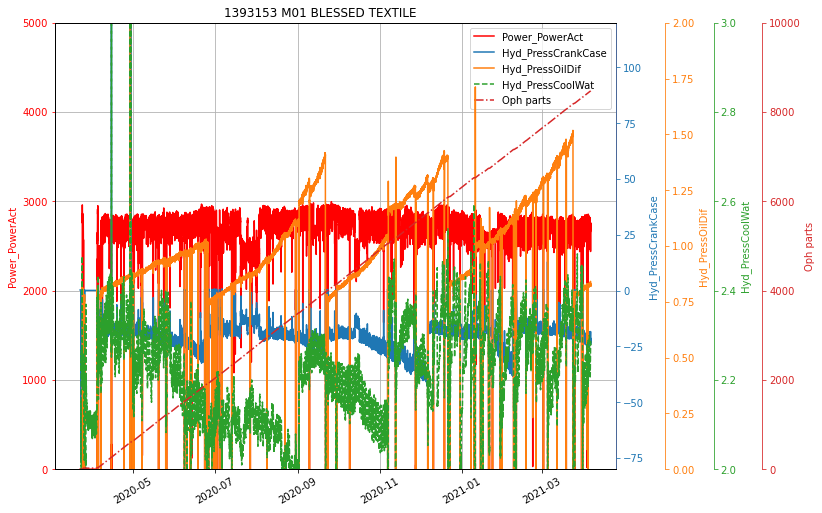

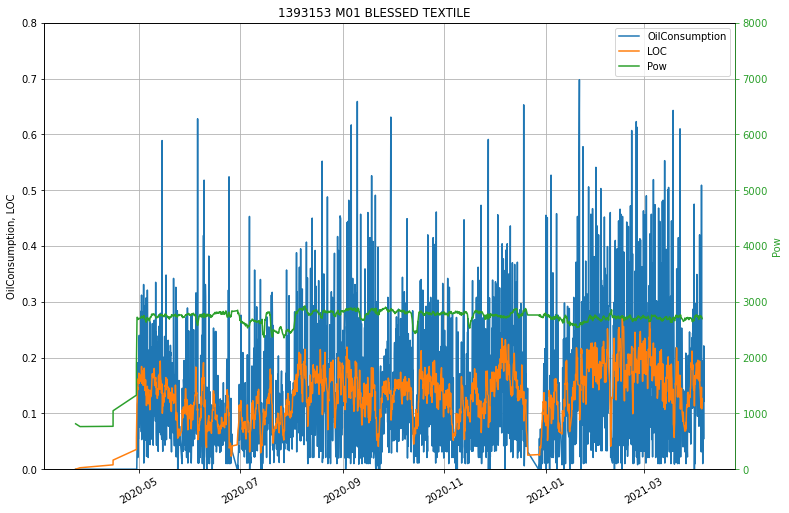

  0%|          | 0/2 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(24107, 7), from: 21.10.2020 - 02:00, to:   06.04.2021 - 11:20, loaded from ./data/1415409_600_00.hdf
20000it [00:00, 25644.30it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(3, 7), from: 06.04.2021 - 11:20, to:   06.04.2021 - 11:48, added to ./data/1415409_600_00.hdf

Plotting no 31, 1415409 M01 Salmmeir 1             

LOC, all available data received,
start 09.05.2019 val start 21.10.2020


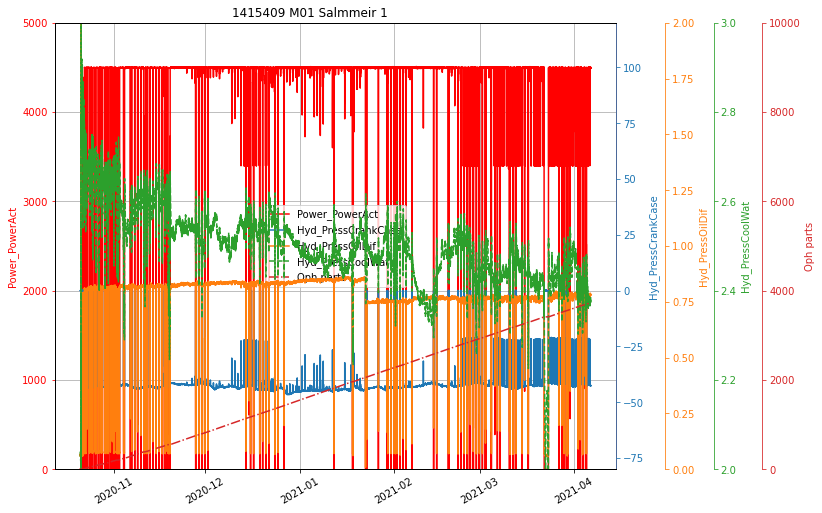

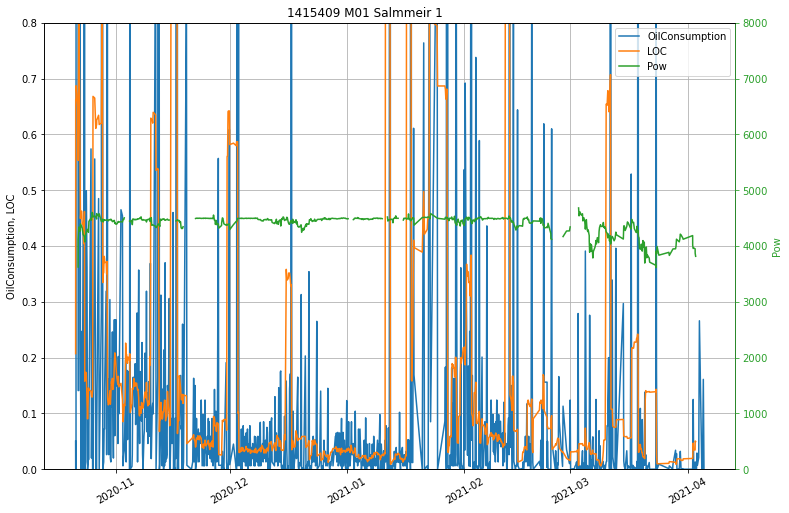

  0%|          | 0/8 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(26835, 7), from: 02.10.2020 - 02:00, to:   06.04.2021 - 10:20, loaded from ./data/1415410_600_00.hdf
20000it [00:00, 32276.81it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(9, 7), from: 06.04.2021 - 10:20, to:   06.04.2021 - 11:48, added to ./data/1415410_600_00.hdf

Plotting no 32, 1415410 M02 Salmmeir 2             

LOC, all available data received,
start 15.11.2019 val start 02.10.2020


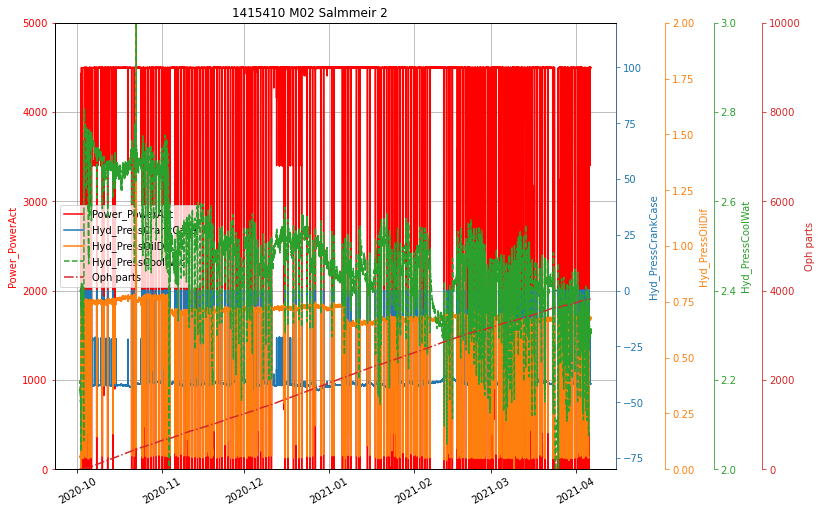

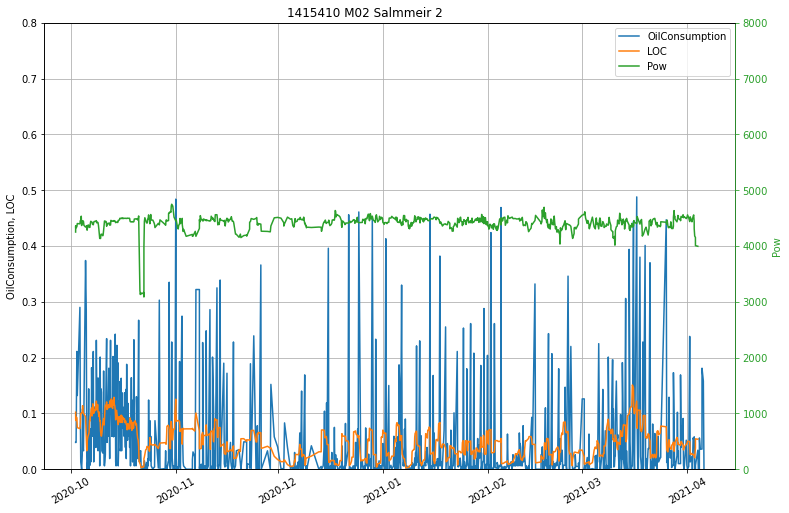

  0%|          | 0/8 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(17188, 7), from: 08.12.2020 - 01:00, to:   06.04.2021 - 10:20, loaded from ./data/1323894_600_00.hdf
20000it [00:00, 32408.54it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(9, 7), from: 06.04.2021 - 10:20, to:   06.04.2021 - 11:48, added to ./data/1323894_600_00.hdf

Plotting no 33, 1323894 M01 Tomaver                

No LOC Information available on Engine 1323894 M01 Tomaver                



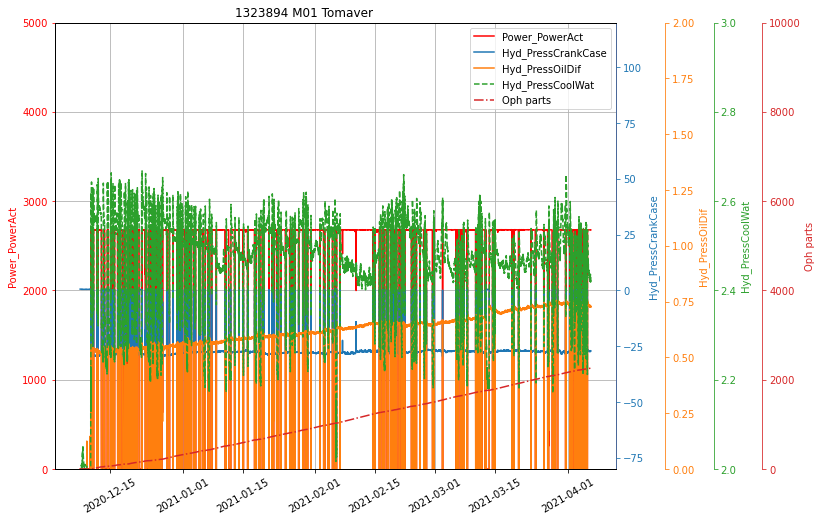

  0%|          | 0/8 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(28707, 7), from: 19.09.2020 - 02:00, to:   06.04.2021 - 10:20, loaded from ./data/1393378_600_00.hdf
20000it [00:00, 27757.95it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(9, 7), from: 06.04.2021 - 10:20, to:   06.04.2021 - 11:49, added to ./data/1393378_600_00.hdf

Plotting no 34, 1393378 M01 KAMAL LIMITED          

LOC, all available data received,
start 26.04.2019 val start 19.09.2020


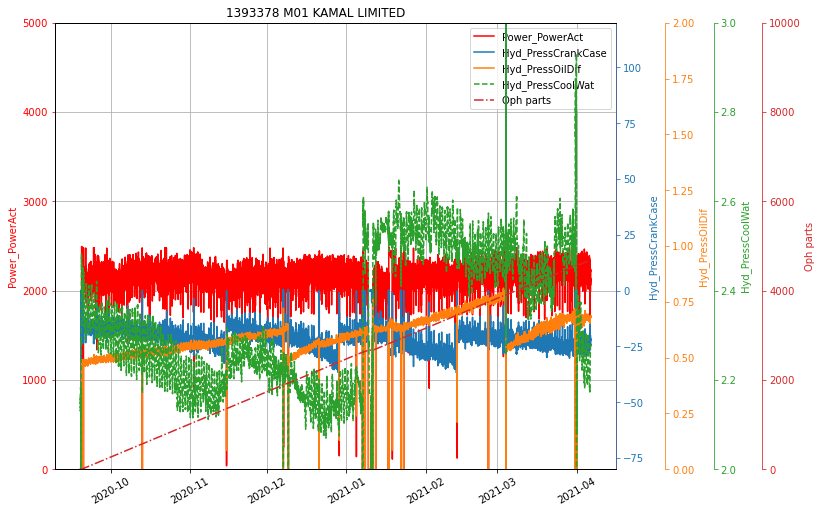

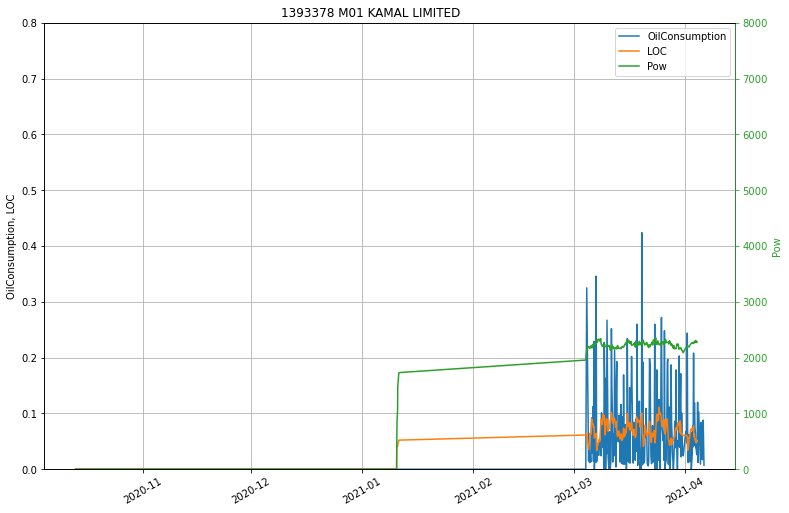

  0%|          | 0/8 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(5812, 7), from: 25.02.2021 - 01:00, to:   06.04.2021 - 10:20, loaded from ./data/1225799_600_00.hdf
20000it [00:00, 20522.26it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(9, 7), from: 06.04.2021 - 10:20, to:   06.04.2021 - 11:49, added to ./data/1225799_600_00.hdf

Plotting no 35, 1225799 M01 EC Mielec              

LOC, all available data received,
start 14.06.2018 val start 25.02.2021


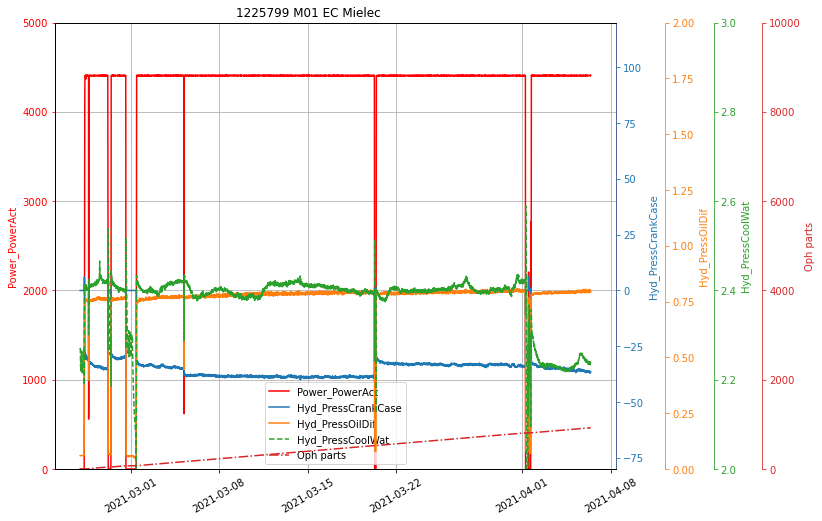

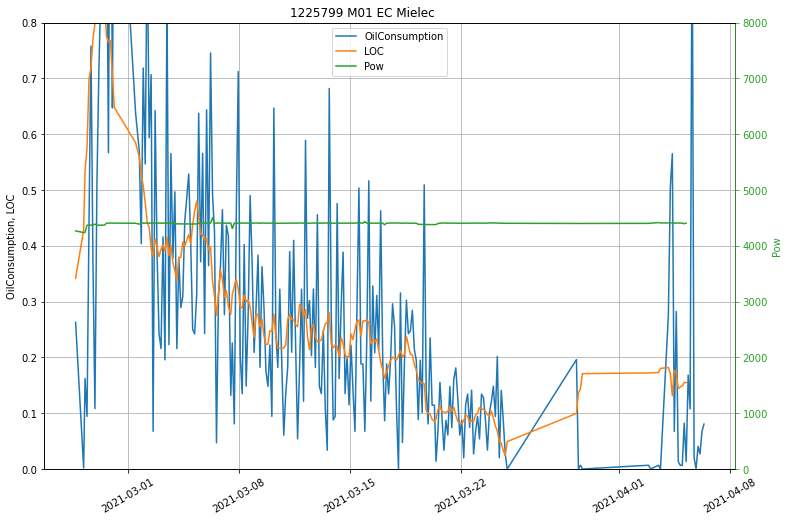

Wall time: 3min 18s


In [4]:
%%time
runplots(20,35, dat3, dset3)